In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import zipfile
import os
import math
from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving qr_test.zip to qr_test (1).zip


In [ ]:
zip_filename = list(uploaded.keys())[0]
extract_path = '/content/dataset'

os.makedirs(extract_path, exist_ok=True)

with zipfile.ZipFile(zip_filename, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print("Extracted to:", extract_path)

Extracted to: /content/dataset


Loaded: 355 images


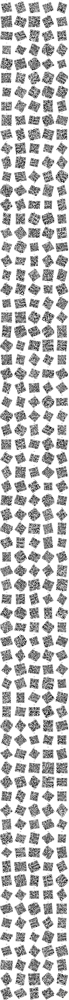

In [ ]:
#Acquisition
inner_path = '/content/dataset/qr_test'

images = []
for filename in os.listdir(inner_path):
    path = os.path.join(inner_path, filename)
    img = cv2.imread(path)
    if img is not None:
        images.append(img)

print("Loaded:", len(images), "images")
n = len(images)
cols = 5
rows = math.ceil(n / cols)

plt.figure(figsize=(15, 3 * rows))

for i, img in enumerate(images):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img, cmap='gray')
    plt.title(f"{i}")
    plt.axis('off')

plt.tight_layout()
plt.show()

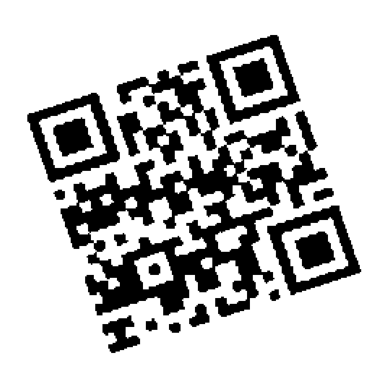

In [ ]:
#Enhancement
kernel = np.array([[0, -1, 0],
                   [-1, 5, -1],
                   [0, -1, 0]]) #standard sharpening kernel
enhanced = []
for img in images:
        img = cv2.resize(img, (256, 256))
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        sharpened = cv2.filter2D(gray, -1, kernel)
        _, binary = cv2.threshold(sharpened, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        enhanced.append(binary)
plt.imshow(enhanced[335], cmap='gray')
plt.axis('off')
plt.show()

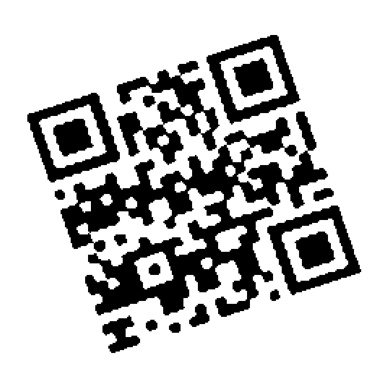

In [ ]:
#Restoration
restored = []
ksize = 3
for binary_img in enhanced:

    final_restored = cv2.medianBlur(binary_img, ksize) #median blur is the best soltuion for salt and pepper noise
    restored.append(final_restored)

plt.imshow(restored[335], cmap='gray')
plt.axis('off')
plt.show()

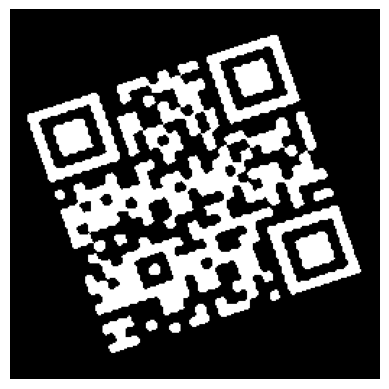

In [ ]:
#inverting binary image after restoration
inverted_images = []

for restored_img in restored:
    inverted = cv2.bitwise_not(restored_img)
    #converting black to white and vice versa

    inverted_images.append(inverted)


plt.imshow(inverted_images[335], cmap='gray')
plt.axis('off')
plt.show()

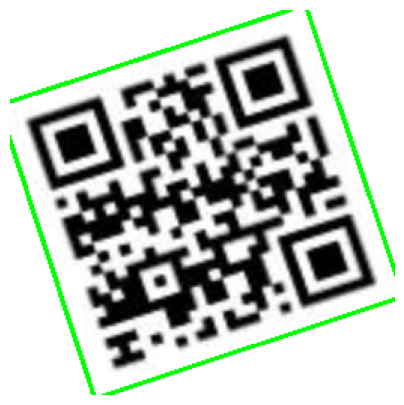

In [ ]:
#segmentation
contour_visualization = []
potential_qr_boxes = []
padding_percentage = 0.1  # Increased padding

kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5)) #creates a morhpological kernel

for i, img_binary in enumerate(inverted_images):

    #using dilation to fill small gaps with white, iterations 2 to expand more
    merged = cv2.dilate(img_binary, kernel, iterations=2)

    #hierarchy ignored, returning boundaries of outermost contours of the white object
    contours, _ = cv2.findContours(merged, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) #memory efficiency

    #resizing to original color and image for visualization
    img_color = cv2.resize(images[i], (256, 256))

    if contours:
        best_contour = max(contours, key=cv2.contourArea) #outermost bouding contour to detect the whole QR code largest contour by area

        rect = cv2.minAreaRect(best_contour) #smallest rectangle bounding the object even if rotated
        center, (width, height), angle = rect

        width *= (1 + padding_percentage) #padding the bouding rectangle
        height *= (1 + padding_percentage)
        padded_rect = (center, (width, height), angle)

        box = cv2.boxPoints(padded_rect) #4 corner points of qr code detector
        box = np.intp(box) #converting to int to draw

        cv2.drawContours(img_color, [box], 0, (0, 255, 0), 2)
        potential_qr_boxes.append(box)
    else:
        potential_qr_boxes.append(None)

    contour_visualization.append(img_color)

plt.figure(figsize=(5,5))
plt.imshow(cv2.cvtColor(contour_visualization[335], cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [ ]:
#decoding
decoded_links = []
detector = cv2.QRCodeDetector() #detect and decode

for i, box in enumerate(potential_qr_boxes):
    if box is None: #4coordinates of qr code
        decoded_links.append(None)
        continue

    original = cv2.resize(images[i], (256, 256))

    x_min = int(max(min(box[:, 0]), 0))
    x_max = int(min(max(box[:, 0]), original.shape[1] - 1))
    y_min = int(max(min(box[:, 1]), 0))
    y_max = int(min(max(box[:, 1]), original.shape[0] - 1))

    qr_crop = original[y_min:y_max, x_min:x_max] #cropping the exact qr code

    if qr_crop.size == 0: #if cropped area is empty
        decoded_links.append(None)
        continue

    h, w = qr_crop.shape[:2] #take only the first two elements of the shape tuple, IGNORE BGR
    scale = 4
    resized = cv2.resize(qr_crop, (w*scale, h*scale), interpolation=cv2.INTER_LINEAR) #enlarging image smoothly

    qr_gray = cv2.cvtColor(resized, cv2.COLOR_BGR2GRAY) #conversion code to grey
    data, points, _ = detector.detectAndDecode(qr_gray)
    decoded_links.append(data if data else None)

print("Decoding Results:")
for i, link in enumerate(decoded_links):
    if link is not None and link != '':
        print(f"Image {i}: Decoded link - {link}")


Decoding Results:
Image 0: Decoded link - 7788
Image 2: Decoded link - 8375
Image 3: Decoded link - 6451
Image 5: Decoded link - 7796
Image 7: Decoded link - 1031
Image 9: Decoded link - 7021
Image 10: Decoded link - 3909
Image 12: Decoded link - 3557
Image 14: Decoded link - 4970
Image 15: Decoded link - 1787
Image 24: Decoded link - 2505
Image 25: Decoded link - https://shahid.mbc.net
Image 26: Decoded link - 5854
Image 30: Decoded link - 6853
Image 35: Decoded link - 2420
Image 38: Decoded link - 1982
Image 40: Decoded link - 3706
Image 41: Decoded link - 6812
Image 42: Decoded link - 6761
Image 45: Decoded link - 5823
Image 48: Decoded link - 3451
Image 49: Decoded link - 3657
Image 50: Decoded link - 5513
Image 51: Decoded link - 2891
Image 52: Decoded link - 5822
Image 54: Decoded link - 7195
Image 60: Decoded link - 1675
Image 61: Decoded link - 5665
Image 72: Decoded link - 1355
Image 73: Decoded link - 1520
Image 75: Decoded link - 7564
Image 79: Decoded link - 5513
Image 80: 